### Se vuela para abajo

[*********************100%***********************]  12 of 12 downloaded


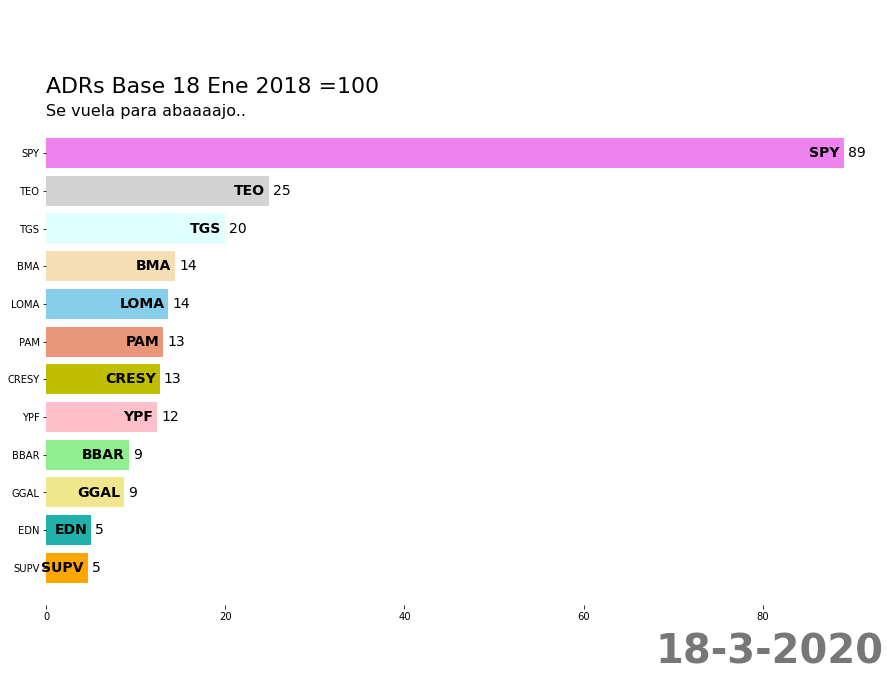

In [1]:
import yfinance as yf
colores = {'BBAR':'lightgreen','BMA':'wheat','CRESY':'y','EDN':'lightseagreen','GGAL':'khaki','LOMA':'skyblue',
           'PAM':'darksalmon', 'SUPV':'orange','TEO':'lightgray','TGS':'lightcyan','YPF':'pink','SPY':'violet'}
tickers = list(colores.keys())
tickers.sort()

df = yf.download(tickers, start='2018-01-18', end='2020-03-20')['Adj Close']
df = df.resample('2D').last().dropna()
df = df.stack().reset_index()
df.columns = ['Fecha','Ticker','Precio']
df['Ruedas'] = df.Fecha.rank()//len(tickers)

max_inicial = df.iloc[:len(tickers)].Precio
max_inicial.index=tickers
for t in tickers:
    df.loc[df.Ticker==t, 'Precio_Base_100'] = 100 * df.loc[df.Ticker==t].Precio / max_inicial[t]

def draw_barchart(rueda):
    dff = df[df['Ruedas'].eq(rueda)].sort_values(by='Precio_Base_100', ascending=True).tail(12)
    c = [colores[ti] for ti in list(dff['Ticker'])]
    ax.clear()
    ax.barh(dff['Ticker'], dff['Precio_Base_100'], color=c )
    dx = dff['Precio_Base_100'].max() / 200
    for i, (valor, t) in enumerate(zip(dff['Precio_Base_100'], dff['Ticker'])):
        ax.text(valor-dx, i, t, size=14, weight=600, ha='right', va='center')
        ax.text(valor+dx, i, f'{valor:,.0f}',  size=14, ha='left',  va='center')

    f = list(df.loc[df.Ruedas==rueda].Fecha)[0]
    fecha_format = f'{f.day}-{f.month}-{f.year}'
    ax.text(1, -0.12, fecha_format, transform=ax.transAxes, color='#777777', size=40, ha='right', weight=600)
    ax.text(0, 1, '\n\n\nADRs Base 18 Ene 2018 =100\n', transform=ax.transAxes, size=22, ha='left')
    ax.text(0, 1, 'Se vuela para abaaaajo..', transform=ax.transAxes, size=16, ha='left')
    plt.box(False)
    
import matplotlib.animation as animation, matplotlib.pyplot as plt
from IPython.display import HTML
fig, ax = plt.subplots(figsize=(15, 9))
HTML(animation.FuncAnimation(fig, draw_barchart, frames=range(len(df)//len(tickers))).to_jshtml()) 